In [1]:
%load_ext autoreload
%autoreload 2
import bento
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from tqdm.auto import tqdm

In [2]:
sc.set_figure_params(dpi=100, dpi_save=300)

In [3]:
folder = (
    "/cellar/users/ckmah/spatial/data/Resolve-32786-slide5_submission_20221108"
)

paths = [
    f"{folder}/32786-slide5_A1-1.h5ad",
    f"{folder}/32786-slide5_A2-1.h5ad",
    f"{folder}/32786-slide5_B1-1.h5ad",
    f"{folder}/32786-slide5_B2-1.h5ad",
]

In [4]:
adatas = []
for p in tqdm(paths):
    adata = bento.io.read_h5ad(p)
    adatas.append(adata)

adata_all = bento.io.concatenate(adatas)

  0%|          | 0/4 [00:00<?, ?it/s]

In [5]:
adata_all.obs["batch"] = (
    adata_all.obs["batch"]
    .astype(str)
    .map(
        {
            "0": "vehicle1",
            "1": "vehicle2",
            "2": "treatment1",
            "3": "treatment2",
        }
    )
)
adata_all.uns["points"]["batch"] = (
    adata_all.uns["points"]["batch"]
    .astype(str)
    .map(
        {
            "0": "vehicle1",
            "1": "vehicle2",
            "2": "treatment1",
            "3": "treatment2",
        }
    )
)

In [6]:
adata_sc = bento.ut.sc_format(adata_all, copy=True)

In [7]:
sc.pp.normalize_total(adata_sc)
sc.pp.log1p(adata_sc)
sc.pp.pca(adata_sc)
sc.pp.neighbors(adata_sc)
sc.tl.umap(adata_sc)

In [8]:
sc.tl.leiden(adata_sc, resolution=0.5)

... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical


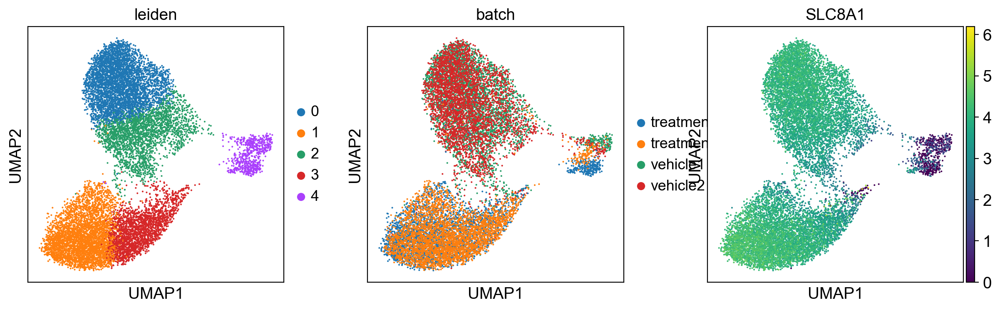

In [9]:
sc.pl.umap(
    adata_sc, color=["leiden", "batch", "SLC8A1"], save="cardio_umaps.svg"
)

Subset `adata_all` for bento

In [10]:
adata_all = adata_all[adata_sc.obs["leiden"] != "4"]
adata_all = adata_all[adata_all.obs["nucleus_shape"] != None]

bento.ut.sync(adata_all)

Trying to set attribute `._uns` of view, copying.


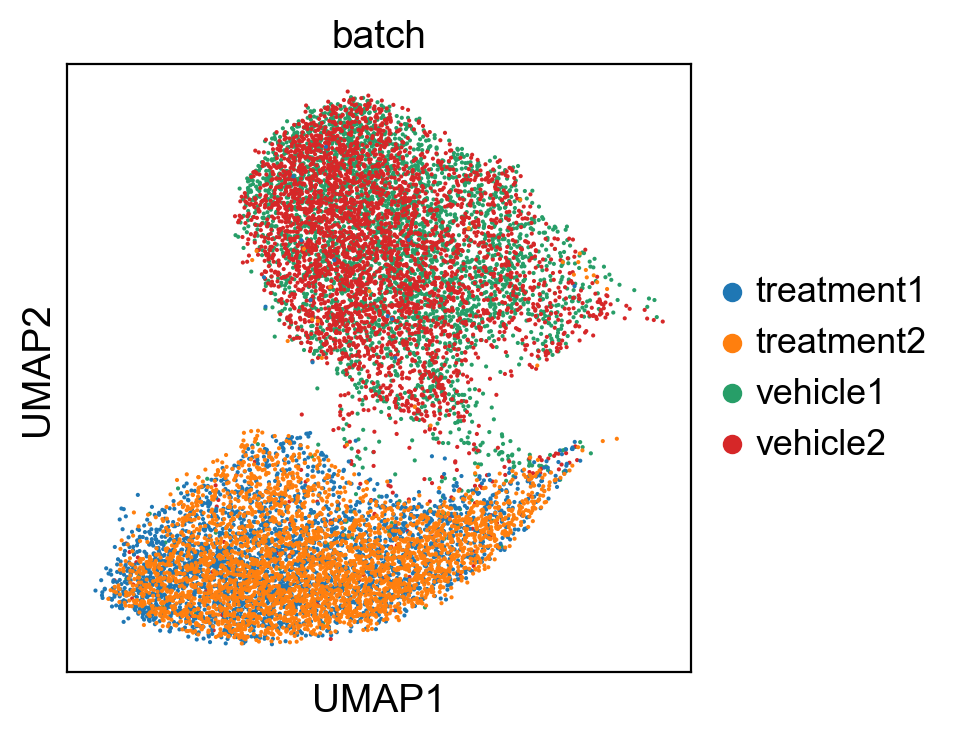

In [11]:
sc.pl.umap(
    adata_sc[adata_sc.obs["leiden"] != "4"],
    color="batch",
    save="cardio_batch_no4.svg",
)

In [12]:
adata_diff = adata_sc[adata_sc.obs["leiden"] != "4"]
bento.ut.sc_format(adata_diff)

Trying to set attribute `.obs` of view, copying.


In [13]:
adata_diff.obs["batch"] = adata_diff.obs["batch"].apply(lambda s: s[:-1])

In [14]:
sc.tl.rank_genes_groups(adata_diff, "batch", method="wilcoxon", pts=True)

... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical


In [15]:
de = sc.get.rank_genes_groups_df(adata_diff, "treatment")
de["-log10_padj"] = -np.log10(de["pvals_adj"])
de["-log10_padj"] = de["-log10_padj"].clip(upper=150)
de_top = de.sort_values("-log10_padj").tail(20)

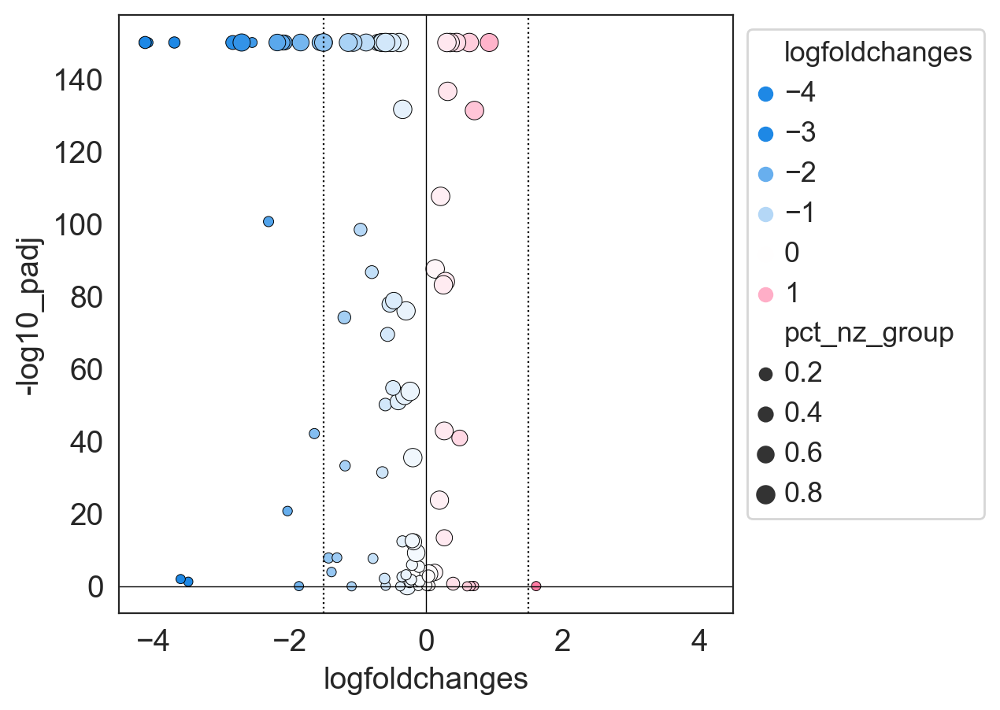

In [16]:
with sns.axes_style("white"):
    plt.figure(figsize=(5, 5))
    ax = sns.scatterplot(
        data=de,
        x="logfoldchanges",
        y="-log10_padj",
        hue="logfoldchanges",
        size="pct_nz_group",
        hue_norm=(-3, 3),
        palette=bento.colors.red2blue,
        edgecolor="black",
    )
    # ax.axhline(-np.log10(0.05), c="black", ls=":", lw)
    ax.axvline(0, c="black", lw=0.5)
    ax.axhline(0, c="black", lw=0.5)
    ax.axvline(-1.5, c="black", ls=":", lw=0.8)
    ax.axvline(1.5, c="black", ls=":", lw=0.8)
    ax.set_xlim(-4.5, 4.5)
    plt.legend(bbox_to_anchor=[1, 1])

    plt.savefig(
        "/cellar/users/ckmah/spatial/figures/cardio_12_de_volcano.svg", dpi=300
    )

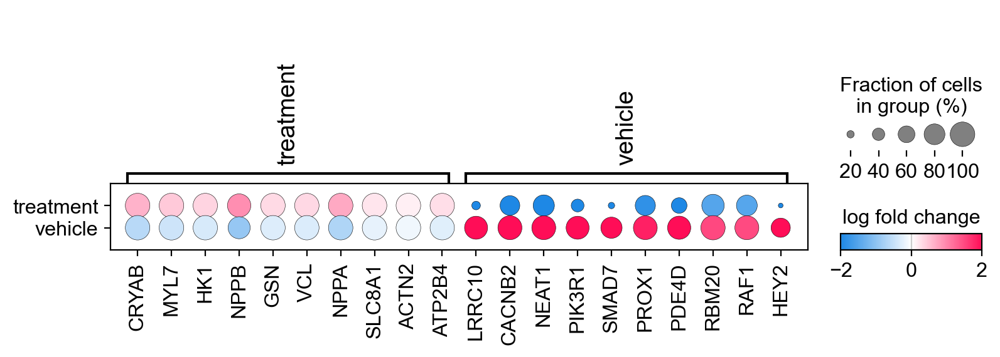

In [17]:
with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    sc.pl.rank_genes_groups_dotplot(
        adata_diff,
        values_to_plot="logfoldchanges",
        cmap=bento.colors.red2blue,
        vmax=2,
        vmin=-2,
        save="cardio_12_de_dotplot.svg",
    )

In [4]:
batch_names = ["vehicle1", "treatment1"]
dx = 0.138

In [19]:
adatas = []
crop_bounds = [(2000, 5500), (6000, 9500)]
bento.ut.geo_format(adata_all)
for batch in tqdm(batch_names):
    adata = adata_all[adata_all.obs["batch"] == batch]
    bento.ut.sync(adata)
    adata = bento.geo.crop(adata, crop_bounds[0], crop_bounds[1])
    bento.tl.flux(adata, radius=50, res=0.2)
    bento.tl.fluxmap(adata, n_clusters=4, res=0.2)
    del adata.obs["cell_raster"]
    bento.io.write_h5ad(adata, f"{folder}/{batch}_fluxmap.h5ad")
    adatas.append(adata)

  0%|          | 0/2 [00:00<?, ?it/s]

Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.


  0%|          | 0/3 [00:00<?, ?it/s]

AnnData object modified:
    obs:
        + cell_raster
    uns:
        + cell_raster


  0%|          | 0/277 [00:00<?, ?it/s]

AnnData object modified:
    obs:
        + cell_raster
    uns:
        + flux_embed, flux_color, flux_genes, flux, flux_variance_ratio, cell_raster


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/277 [00:00<?, ?it/s]

  0%|          | 0/277 [00:00<?, ?it/s]

AnnData object modified:
    obs:
        + fluxmap1_shape, fluxmap2_shape, fluxmap4_shape, fluxmap3_shape


... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical
... storing 'fluxmap1_shape' as categorical
... storing 'fluxmap2_shape' as categorical
... storing 'fluxmap3_shape' as categorical
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.


  0%|          | 0/3 [00:00<?, ?it/s]

AnnData object modified:
    obs:
        + cell_raster
    uns:
        + cell_raster


  0%|          | 0/182 [00:00<?, ?it/s]

AnnData object modified:
    obs:
        + cell_raster
    uns:
        + flux_embed, flux_color, flux_genes, flux, flux_variance_ratio, cell_raster


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/182 [00:00<?, ?it/s]

  0%|          | 0/182 [00:00<?, ?it/s]

AnnData object modified:
    obs:
        + fluxmap1_shape, fluxmap2_shape, fluxmap4_shape, fluxmap3_shape


... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical


In [5]:
adatas = []
for batch in tqdm(batch_names):
    adata = bento.io.read_h5ad(f"{folder}/{batch}_flowmap.h5ad")
    adatas.append(adata)

  0%|          | 0/2 [00:00<?, ?it/s]

In [6]:
sns.color_palette("Spectral", n_colors=4)

[(0.9568627450980393, 0.42745098039215684, 0.2627450980392157),
 (0.996078431372549, 0.8784313725490196, 0.5450980392156862),
 (0.9019607843137256, 0.9607843137254902, 0.5960784313725491),
 (0.4, 0.7607843137254902, 0.6470588235294118)]

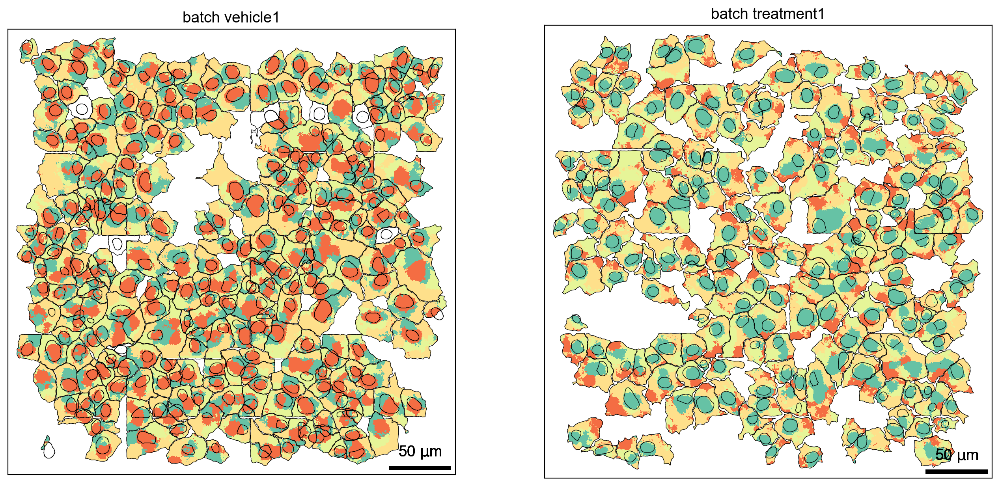

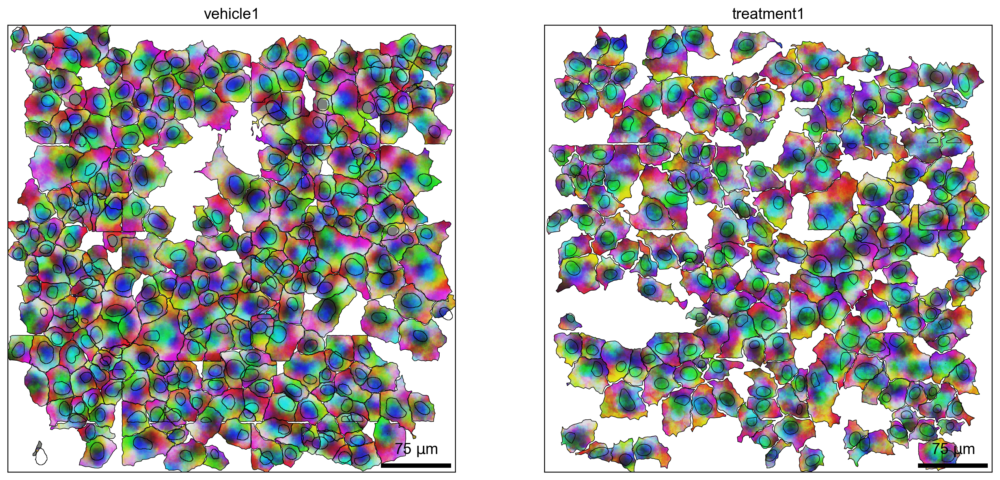

In [21]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas, batch_names, axes):
    bento.pl.fluxmap(
        adata,
        palette="Spectral",
        color_style="fill",
        dx=dx,
        lw=0,
        ax=ax,
        title=batch,
        square=True
        # fname=f"/cellar/users/ckmah/spatial/figures/{batch}_flowmap.svg",
    )

fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas, batch_names, axes):
    bento.pl.flux(
        adata,
        res=0.2,
        dx=dx,
        ax=ax,
        title=batch,
        square=True,
        #     fname=f"/cellar/users/ckmah/spatial/figures/{batch}_flow.svg",
    )

---

# Domain enrichment

In [22]:
bento.tl.fe_fazal2019(adatas[0])
bento.tl.fe_fazal2019(adatas[1])

28 samples of mat are empty, they will be removed.
Running wsum on mat with 351428 samples and 96 targets for 8 sources.
Infering activities on 36 batches.


100%|██████████| 36/36 [01:26<00:00,  2.39s/it]


AnnData object modified:
    uns:
        + fe_ngenes, flux_ER Lumen, fe_stats, flux_Lamina, flux_ERM, flux_Nuclear Pore, flux_Nucleolus, flux_Nucleus, flux_OMM, flux_Cytosol
Running wsum on mat with 302727 samples and 92 targets for 8 sources.
Infering activities on 31 batches.


100%|██████████| 31/31 [01:11<00:00,  2.29s/it]


AnnData object modified:
    uns:
        + fe_ngenes, flux_ER Lumen, fe_stats, flux_Lamina, flux_ERM, flux_Nuclear Pore, flux_Nucleolus, flux_Nucleus, flux_OMM, flux_Cytosol


In [23]:
for adata, batch in zip(adatas, batch_names):
    bento.io.write_h5ad(adata, f"{folder}/{batch}_fluxmap.h5ad")

... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical
... storing 'fluxmap1_shape' as categorical
... storing 'fluxmap2_shape' as categorical
... storing 'fluxmap3_shape' as categorical
... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical


In [177]:
@bento.pl._utils.savefig
def plot_domain_fe(data, fname=None):
    domains = [
        "flux_Cytosol",
        "flux_Nucleus",
        "flux_ERM",
        "flux_Nucleolus",
        "flux_ER Lumen",
        "flux_OMM",
        "flux_Nuclear Pore",
        "flux_Lamina",
    ]

    domain_fe = pd.DataFrame(
        np.stack([data.uns[d] for d in domains], axis=1),
        index=data.uns["cell_raster"].index,
        columns=domains,
    )

    domain_fe = domain_fe.groupby(data.uns["cell_raster"]["fluxmap"]).mean()
    domain_fe.columns = [d.split("flux_")[1] for d in domain_fe.columns]

    with sns.axes_style("white"):
        g = sns.clustermap(
            domain_fe.T,
            center=0,
            cmap=bento.colors.red2blue,
            figsize=(4, 4.5),
        )
        g.ax_heatmap.spines[:].set_visible(True)

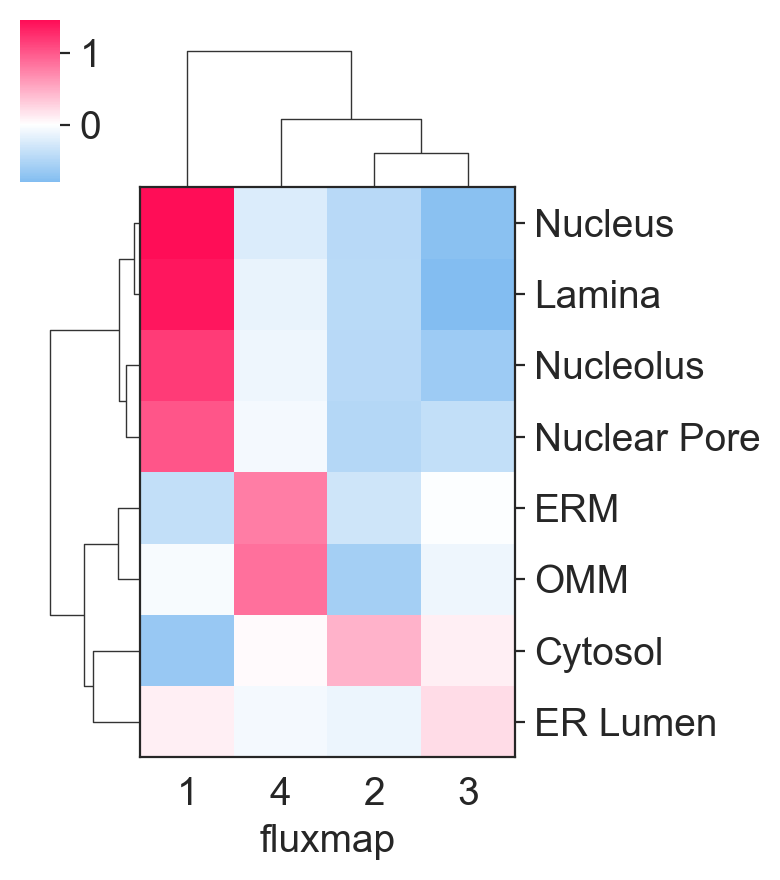

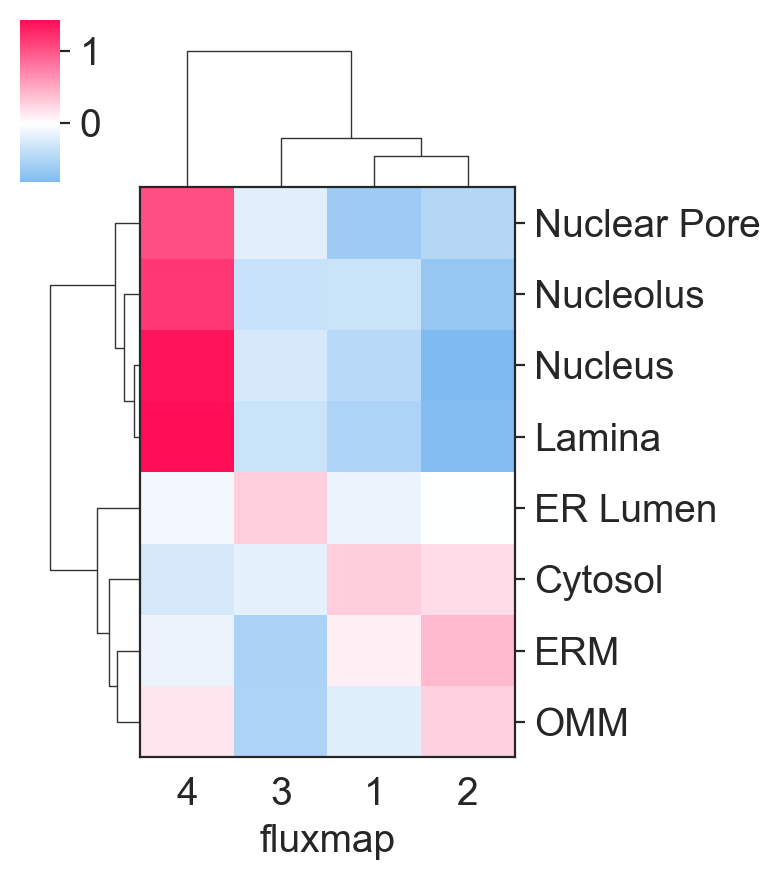

In [25]:
for adata, batch in zip(adatas[:2], batch_names[:2]):
    plot_domain_fe(
        adata,
    )

# Assign domain colors

In [26]:
# TODO map to nucleus, outside nucleus
flowmap_map = {
    "vehicle1": {
        "1": "1",
        "2": "4",
        "3": "3",
        "4": "2",
    },
    "treatment1": {
        "1": "4",
        "2": "2",
        "3": "3",
        "4": "1",
    },
}

pt_map = dict()
shape_map = dict()
for batch, mp in flowmap_map.items():
    pt_map[batch] = dict()
    shape_map[batch] = dict()
    for key, val in mp.items():
        pt_map[batch][f"fluxmap{key}"] = f"fluxmap{val}"
        shape_map[batch][f"fluxmap{key}_shape"] = f"fluxmap{val}_shape"

Remap domain numbers so matching domains are the same number

In [27]:
for adata, batch in zip(adatas[:2], batch_names[:2]):
    adata.uns["cell_raster"]["fluxmap"] = (
        adata.uns["cell_raster"]["fluxmap"].astype(str).map(flowmap_map[batch])
    )

    adata.uns["points"] = adata.uns["points"].rename(columns=pt_map[batch])
    adata.obs = adata.obs.rename(columns=shape_map[batch])

In [28]:
for adata, batch in zip(adatas, batch_names):
    bento.io.write_h5ad(adata, f"{folder}/{batch}_flowmap.h5ad")

... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical
... storing 'fluxmap1_shape' as categorical
... storing 'fluxmap4_shape' as categorical
... storing 'fluxmap3_shape' as categorical
... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical


Saved to /cellar/users/ckmah/spatial/figures/cardio_vehicle1_fe_heatmap.svg
Saved to /cellar/users/ckmah/spatial/figures/cardio_treatment1_fe_heatmap.svg


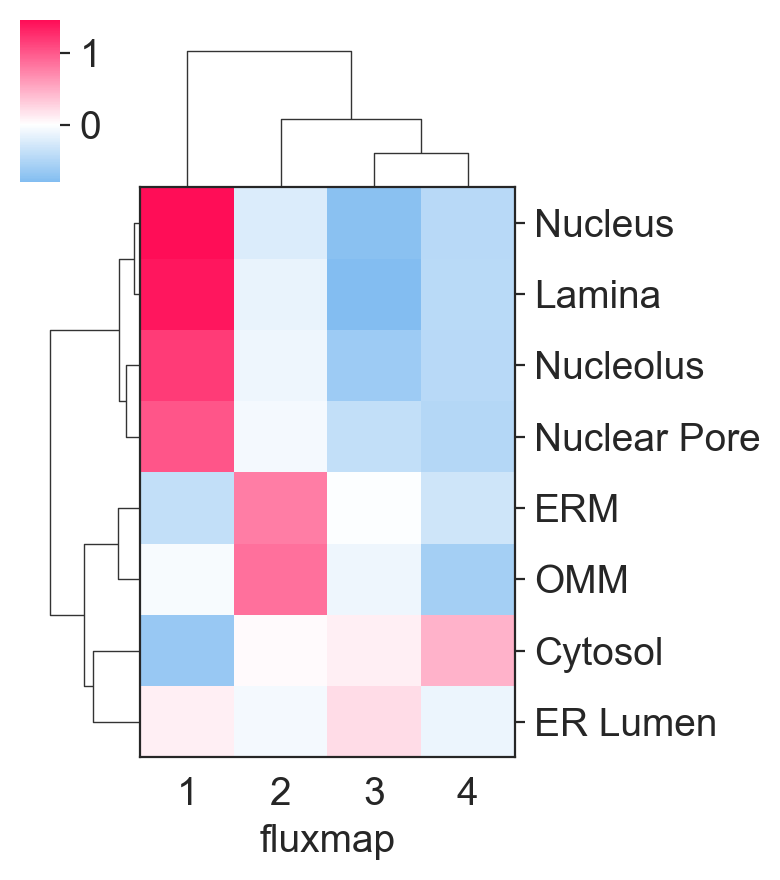

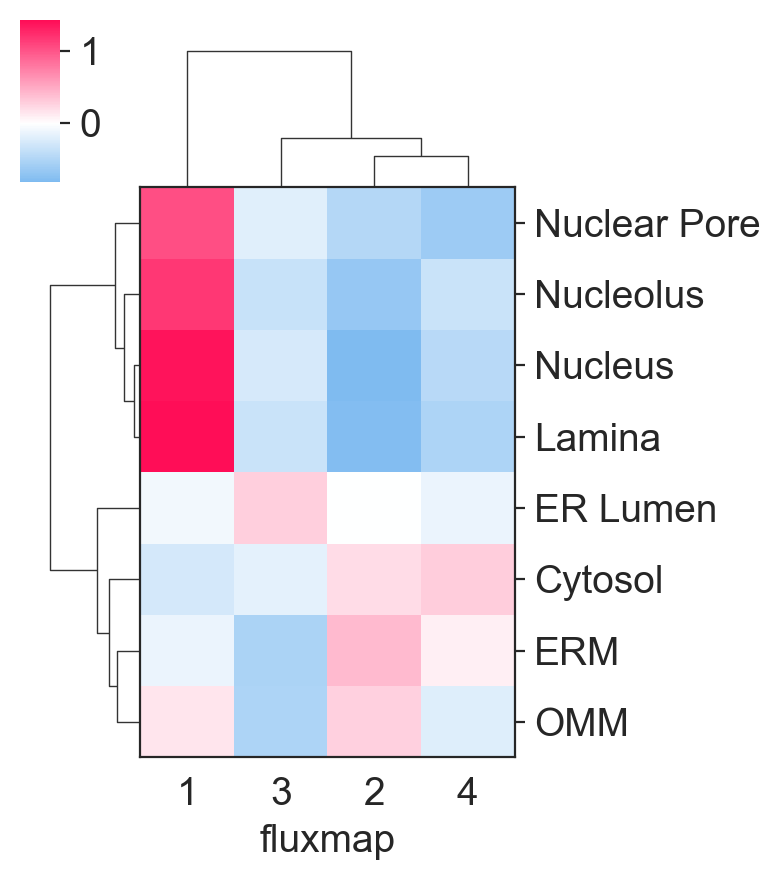

In [178]:
for adata, batch in zip(adatas[:2], batch_names[:2]):
    plot_domain_fe(
        adata,
        fname=f"/cellar/users/ckmah/spatial/figures/cardio_{batch}_fe_heatmap.svg",
    )

In [9]:
domain_palette = {
    "fluxmap1": sns.desaturate("#ef476f", 0.85),
    "fluxmap2": sns.desaturate("#FFD166", 0.85),
    "fluxmap3": sns.desaturate("#118AB2", 0.85),
    "fluxmap4": sns.desaturate("#06D6A0", 0.85),
}

Saved to /cellar/users/ckmah/spatial/figures/vehicle1_fluxmap.svg
Saved to /cellar/users/ckmah/spatial/figures/treatment1_fluxmap.svg


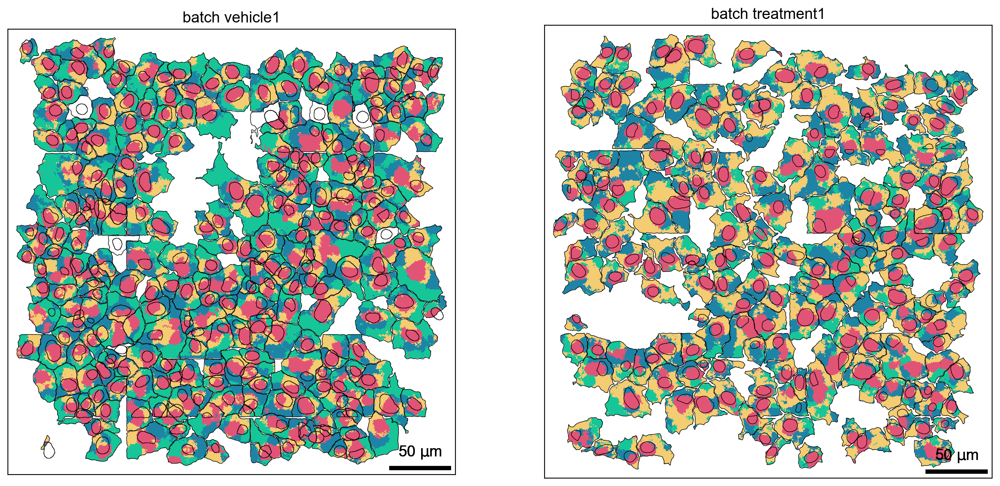

In [31]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas[:2], batch_names[:2], axes):
    bento.pl.fluxmap(
        adata,
        color_style="fill",
        lw=0,
        palette=domain_palette,
        ax=ax,
        fname=f"/cellar/users/ckmah/spatial/figures/{batch}_fluxmap.svg",
    )

Saved to /cellar/users/ckmah/spatial/figures/cardio_vehicle1_flux.svg
Saved to /cellar/users/ckmah/spatial/figures/cardio_treatment1_flux.svg


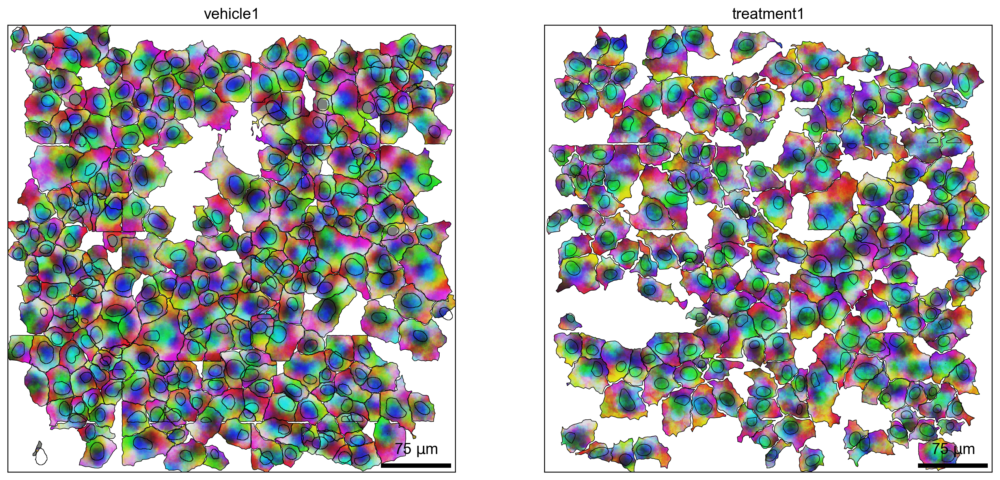

In [32]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas, batch_names, axes):
    bento.pl.flux(
        adata,
        res=0.2,
        dx=dx,
        ax=ax,
        title=batch,
        square=True,
        fname=f"/cellar/users/ckmah/spatial/figures/cardio_{batch}_flux.svg",
    )

---

In [335]:
apex_gs = ["Nucleus", "OMM", "ER", "Cytosol"]
domains = ["1", "2", "3", "4"]

Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.


Saved to /cellar/users/ckmah/spatial/figures/cardio_vehicle1_fe.svg


Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.


Saved to /cellar/users/ckmah/spatial/figures/cardio_treatment1_fe.svg


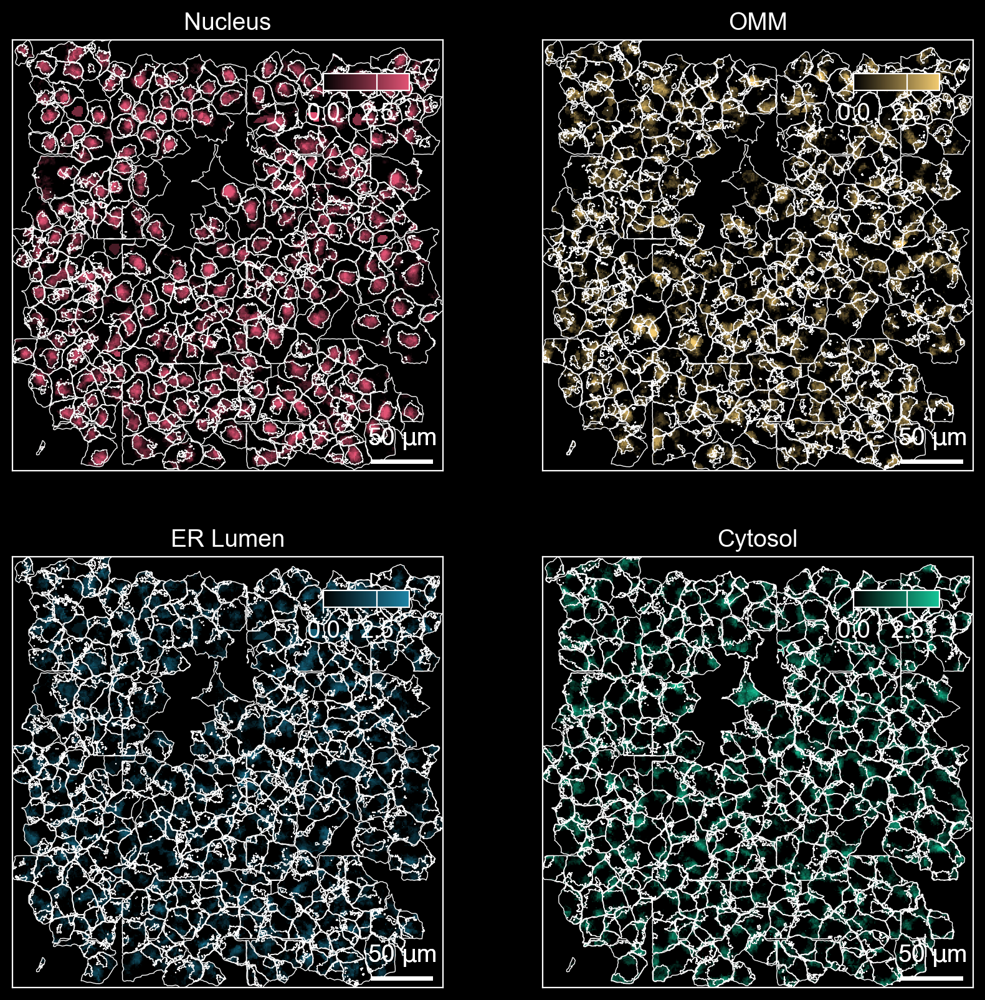

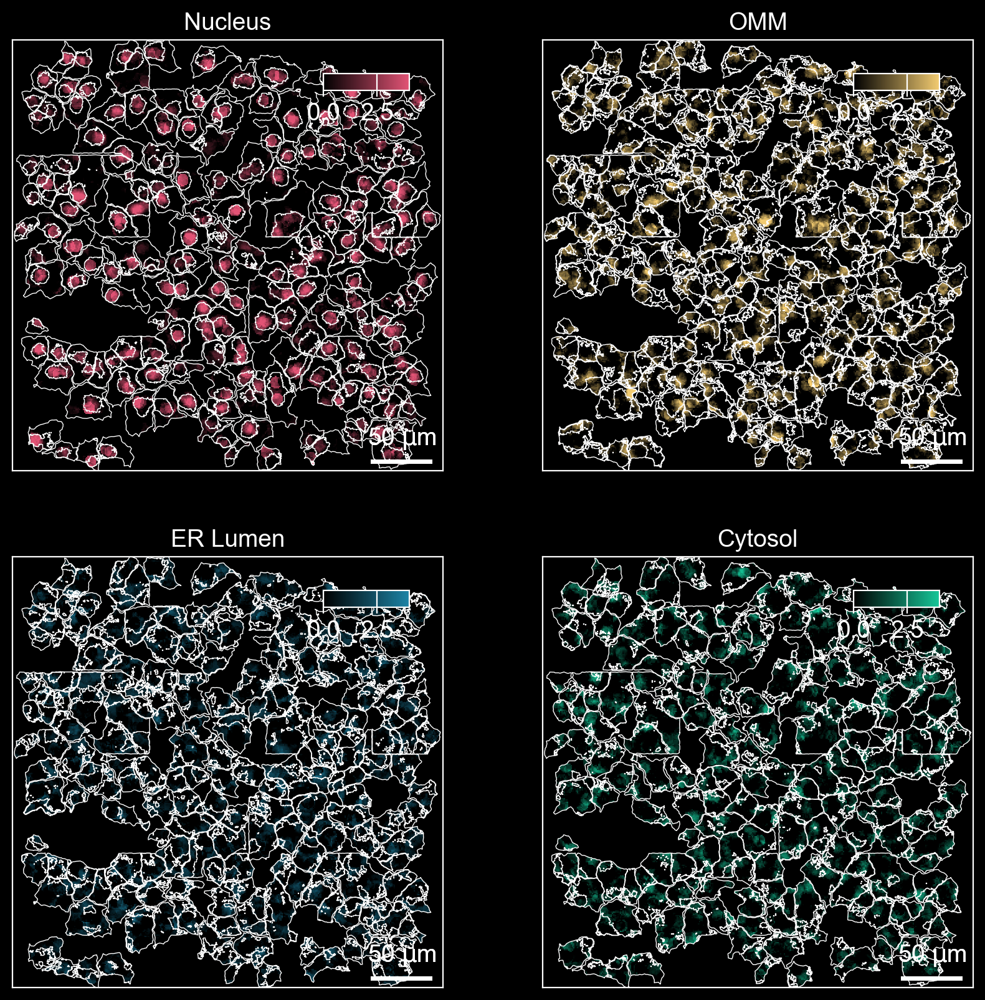

In [174]:
@bento.pl._utils.savefig
def plot_flux_fe(data, batch, fname=None):
    domains = [
        "flux_Cytosol",
        "flux_Nucleus",
        "flux_ERM",
        "flux_Nucleolus",
        "flux_ER Lumen",
        "flux_OMM",
        "flux_Nuclear Pore",
        "flux_Lamina",
    ]

    domain_fe = pd.DataFrame(
        np.stack([data.uns[d] for d in domains], axis=1),
        index=data.uns["cell_raster"].index,
        columns=domains,
    )

    domain_fe = domain_fe.groupby(data.uns["cell_raster"]["fluxmap"]).mean()

    fluxmap2domain = domain_fe.idxmax(axis=1)
    fig, axes = plt.subplots(2, 2, figsize=(10, 10))
    for shape, ax in zip(fluxmap2domain.index, axes.flat):
        cmap = mpl.colors.LinearSegmentedColormap.from_list(
            "fe", ["black", domain_palette[f"fluxmap{shape}"]]
        )
        domain = fluxmap2domain[shape]
        bento.pl.shapes(
            adata,
            shapes=f"fluxmap{shape}",
            color_style="outline",
            ax=ax,
            lw=0.5,
        )
        bento.pl.fe(
            adata,
            domain,
            res=0.1,
            cmap=cmap,
            ax=ax,
            title=domain.split("_")[1],
            shape_kws=dict(shapes=["cell_shape"]),
            square=True,
            vmin=0,
            vmax=4,
        )

    # remove empty axes
    for ax in axes.flat[domain_fe.shape[0] :]:
        ax.remove()
    # plt.subplots_adjust(wspace=0, hspace=0, bottom=0, top=1, left=0, right=1)


for adata, batch in zip(adatas, batch_names):
    with mpl.style.context("dark_background"):
        plot_flux_fe(
            adatas[0],
            batch,
            fname=f"/cellar/users/ckmah/spatial/figures/cardio_{batch}_fe.svg",
        )

---

# Recombine for flow summary

In [113]:
adata_flux_diff = bento.io.concatenate(adatas[:2])

In [114]:
adata_flux_diff.uns["cell_raster"] = pd.concat(
    [adata.uns["cell_raster"] for adata in adatas[:2]], ignore_index=True
)

In [115]:
dims = adata_flux_diff.obs.columns[
    adata_flux_diff.obs.columns.str.startswith("fluxmap")
]

In [121]:
adata_flux_diff.obs["batch"] = adata_flux_diff.obs["batch"].replace(
    {"0": "vehicle1", "1": "treatment1"}
)

In [122]:
bento.tl.comp_diff(adata_flux_diff, dims, "batch", "vehicle1")
comp_diff = adata_flux_diff.uns["batch_comp_stats"]["treatment1"]

In [123]:
top_diff = (
    comp_diff.query("logcounts > 5")
    .query("cell_fraction > 20")
    .sort_values("treatment1_diff", ascending=False)
)

In [128]:
dims

Index(['fluxmap1_shape', 'fluxmap4_shape', 'fluxmap3_shape', 'fluxmap2_shape'], dtype='object')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Adjusting text positions...


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Adjusting text positions...
Saved to /cellar/users/ckmah/spatial/figures/cardio_flux_summary.svg


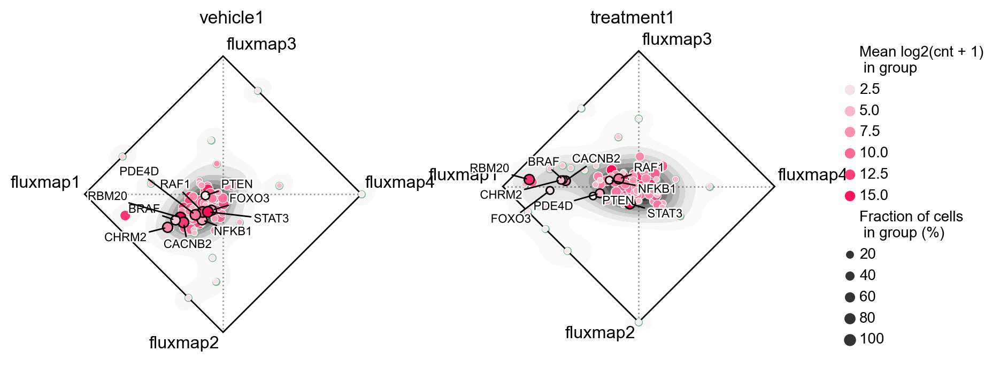

In [173]:
bento.pl.flux_summary(
    adata_flux_diff,
    annotate=top_diff.index[:10].tolist(),
    groupby="batch",
    group_order=["vehicle1", "treatment1"],
    dim_order=["fluxmap4", "fluxmap3", "fluxmap1", "fluxmap2"],
    sizes=(15, 50),
    height=4,
    fname="/cellar/users/ckmah/spatial/figures/cardio_flux_summary.svg",
)

In [7]:
@bento.pl._utils.savefig
def plot_gene(gene, domain, fname=None):
    fig, axes = plt.subplots(1,2,figsize=(12, 6))
    for adata, ax in zip(adatas, axes):
        bento.pl.points(adata[:, gene], c="black", shapes=["cell"], zorder=100, ax=ax)
        bento.pl.shapes(
            adata,
            shapes=[domain],
            color_style="outline",
            color=domain_palette[domain],
            ax=ax
        )
        bento.pl.shapes(
            adata,
            shapes=[domain],
            color_style="fill",
            color=domain_palette[domain],
            alpha=0.4,
            ax=ax,
        )

Saved to /cellar/users/ckmah/spatial/figures/cardio_rbm20.svg


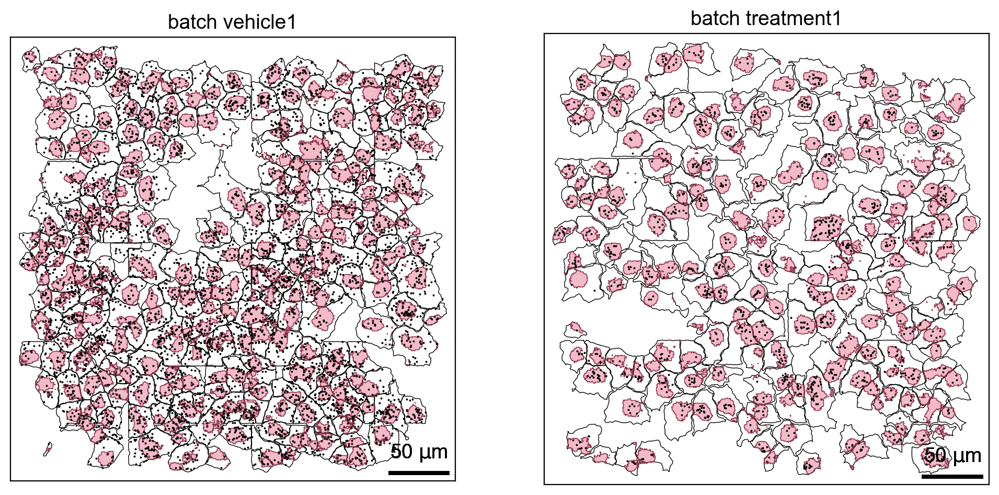

In [12]:
plot_gene("RBM20",'fluxmap1', fname='/cellar/users/ckmah/spatial/figures/cardio_rbm20.svg')

Saved to /cellar/users/ckmah/spatial/figures/cardio_cacnb2.svg


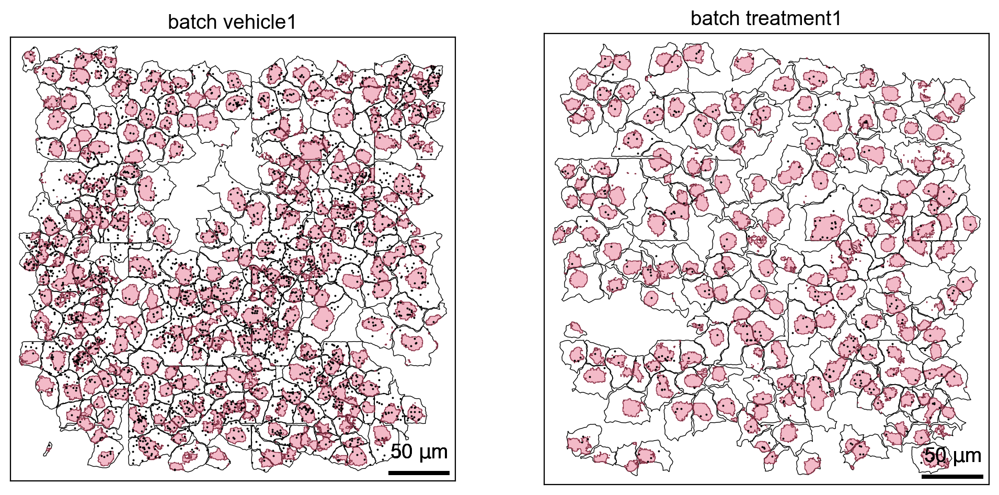

In [13]:
plot_gene("CACNB2", 'fluxmap1', fname='/cellar/users/ckmah/spatial/figures/cardio_cacnb2.svg')

In [14]:
print("a")

a


In [175]:
bento.io.write_h5ad(adatas[0], 'cardio_vehicle1.h5ad')
bento.io.write_h5ad(adatas[1], 'cardio_treatment1.h5ad')

... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical
... storing 'fluxmap1_shape' as categorical
... storing 'fluxmap4_shape' as categorical
... storing 'fluxmap3_shape' as categorical
... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical
